# Tarea 2 [100 puntos totales, posibilidad de obtener >30 puntos extras]
## Diplomado en Ciencia de Datos
### Módulo 2 - Modelos Supervisados

## Descripción
Ayudar a un científic@ de datos a predecir el sentimiento de reseñas que los usuarios de la aplicación móvil de la Institución Financiera para la que trabaja dan acerca de ella. Para ello, tiene un set de datos con el siguiente layout:

**Layout Tabla de datos*:**
* at: Fecha en la que la reseña fue hecha
* content: Texto de la reseña
* repliedAt: Fecha en la que se respondió a la reseña hecha por el usuario
* replyContent: Texto de la respuesta a la reseña hecha por el usuario
* reviewCreatedVersion: Versión de la aplicación móvil que el usuario tenía al dar la reseña de la misma
* reviewId: ID del usuario que escribió la reseña de la aplicación móvil
* thumbsUpCount: Número de pulgares hacía arriba (votos de otros usuarios que apoyan una reseña)
* sentiment: Sentimiento de la reseña escrita por un usuario

**Objetivo:**
En esta tarea deberás ayudar al científic@ de datos a entrenar un modelo supervisado para clasificar los sentimientos de las reseñas de los usuarios de la aplicación móvil.

*Los datos con los que fue hecho este set son públicos

## Importa librerías importantes

In [1]:
# Import useful libraries
import matplotlib.pyplot as plt
import seaborn as sns
import statistics as sts
from scipy import stats
import re
import pandas as pd
import numpy as np
from numpy import zeros
from numpy import asarray
from numpy import array
import itertools
import collections
import csv

# Tunning plots
import matplotlib.lines as mlines
from matplotlib.ticker import MaxNLocator
from wordcloud import WordCloud, ImageColorGenerator
%matplotlib inline
pd.set_option('display.max_columns', 100)
pd.set_option("display.max_rows",100)
SEED = 15432

# scikit-learn
from sklearn.linear_model            import LinearRegression, LogisticRegression, Ridge, RidgeCV, Lasso
from sklearn.svm                     import SVC
from sklearn.ensemble                import RandomForestClassifier
from sklearn.ensemble                import GradientBoostingClassifier
from sklearn.preprocessing           import LabelEncoder,OneHotEncoder
from sklearn.model_selection         import StratifiedKFold
from sklearn.model_selection         import validation_curve
from sklearn.model_selection         import train_test_split
from sklearn.metrics                 import confusion_matrix
from sklearn.metrics                 import accuracy_score
from sklearn.model_selection         import train_test_split
from sklearn.model_selection         import cross_val_predict
from sklearn.model_selection         import cross_val_score
from sklearn                         import metrics
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition           import TruncatedSVD
from sklearn.naive_bayes             import GaussianNB
from sklearn.metrics         import roc_curve, roc_auc_score

# Ignore some warnings 
import warnings
warnings.filterwarnings('ignore')

# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils  import simple_preprocess
from gensim.models import CoherenceModel

# NLTK
import nltk
from nltk.tokenize import word_tokenize
from nltk.tokenize import WordPunctTokenizer
from nltk.stem     import WordNetLemmatizer 
from nltk.corpus   import stopwords

# Read/Write xlsx files
from openpyxl import workbook 
from openpyxl import load_workbook
import os

In [2]:
# Data Wrangling
from functools import reduce

# Web scraping
import requests
from bs4 import BeautifulSoup
from multiprocessing import Pool

# Data cleaning
import unicodedata

# Data visualization
import cufflinks as cf
from IPython.display import Image
from stylecloud import gen_stylecloud
from tensorflow.keras.utils import plot_model
from PIL import Image
import cufflinks as cf
from stylecloud import gen_stylecloud

# Data modeling
from keras import Model
from keras.layers import GRU
from keras.layers import Input
from keras.layers import Dense
from sklearn.cluster import KMeans
from keras.layers import Embedding
from keras.layers import Activation
from keras.layers import concatenate
from tensorflow.keras.optimizers import Adam
from keras.layers import LSTM
from keras.layers import Dropout
from keras.models import Sequential
from keras.layers import SpatialDropout1D
from keras.callbacks import EarlyStopping, ModelCheckpoint

from keras.callbacks import TensorBoard, EarlyStopping, ModelCheckpoint
from keras import metrics

# Data preprocessing
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler
import unicodedata
from langdetect import detect
from bs4 import BeautifulSoup
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize 
from nltk.corpus import stopwords
from sklearn.preprocessing import LabelEncoder
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.utils import to_categorical
from keras.preprocessing.sequence import pad_sequences


# Text mining
from nltk.corpus import stopwords
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from nltk.tokenize import sent_tokenize, word_tokenize 
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Model performance
from keras import metrics
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split, cross_val_score

cf.go_offline()

import nltk
#nltk.download('vader_lexicon')

# Environment setup
cf.go_offline()

## Importa los datos
**Ojo:** importa solo las variables que necesites para la tarea (layout). Intenta nombrar al dataframe **data** 

In [3]:
data=pd.read_csv("data_app_movil.csv")

In [4]:
data.head()

,Unnamed: 0,at,content,repliedAt,replyContent,reviewCreatedVersion,reviewId,thumbsUpCount,sentiment
0,0,2019-11-10 13:21:40,Está muy bien la app lo único que haría falta ...,NaN,NaN,11.12.191105,gp:AOqpTOGfJ1RQk-t56JnOxTN9TmuzS2_tZtmdrRgXhNo...,1069,non-negative
1,1,2019-11-25 18:21:04,El cambio en la interfaz está genial! Me encan...,2019-06-19 13:56:56,¡Hola! Por favor compartenos el caso y tu núme...,11.12.191105,gp:AOqpTOEAtSjey_q34S7Vv9ducNx1DEJoaC-4KYigln0...,1033,non-negative
2,2,2019-09-20 18:30:20,"Excelente aplicación, muy fácil utilizar y ade...",NaN,NaN,11.11.190918,gp:AOqpTOFlEFcvE4bLdXKcB65baO9IvegQJOZxVYtL3Up...,639,non-negative
3,3,2021-03-07 16:52:12,"Normalmente funciona muy bien, pero desde la ú...",2021-03-08 11:28:50,¡Hola Elena! Disculpa el inconveniente ocurrid...,11.31.210220,gp:AOqpTOGI7zmfkQiUHaCNTHsMoxtTWfbz375BDiddsDu...,612,negative
4,4,2019-12-28 01:24:28,"Desde la actualización de la nueva imagen, fal...",2019-12-30 16:32:44,¡Buen día! Queremos brindarte un mejor servici...,11.15.191213,gp:AOqpTOEPPWYdaMJFjOjEmTds4vop9WzcI4BVPhSf8q6...,594,negative


In [5]:
data.shape

(199998, 9)

<div class="alert-info">
Se tiene una tabla con 199,998 registros y 9 atributos, uno de ellos es un id 
<\div>

In [6]:
#Traemos algunas funciones que nos pueden servir
import sys
sys.path.append("Funciones_tarea2/")
from library import *

## Exploración Básica de Datos [15 puntos]
En esta sección tienes que explorar los datos, haz un análisis exhaustivo para responder las siguientes preguntas:

* ¿Cuántos registros y columnas tiene el set de datos?
* ¿Qué porcentaje de valores nulos presenta cada variable? 
* ¿Hay reseñas duplicadas? ¿Cuáles son?
* ¿Cuál es la variable target?
* ¿Cuál es la distribución de la variable target?
* ¿Cuál es la reseña con más apoyo por parte de otros usuarios (thumbsUpCount)?
* ¿Qué porcentaje de reseñas son respondidas por la Institución financiera?
* ¿Cuál es el rango de fechas en las que fueron escritas las reseñas de este set de datos?
* ¿Qué otras cosas básicas crees que vale la pena analizar de este set de datos?

In [7]:
#¿Cuántos registros y columnas tiene el set de datos?
registros=data.shape[0]
columnas=data.shape[1]
print("Se tienen {} registros\n ".format(registros))
print("Con {} columnas".format(columnas))

Se tienen 199998 registros
 
Con 9 columnas


In [8]:
def print_number_dtypes(data):
    """ Function to print the the number of features per data type in a data set
      
        Args:  
        data pandas data frame containing the input variables
    """
    # Determine data types in a data frame
    data_types = pd.DataFrame(data.dtypes)\
                   .reset_index()
    
    # Count how many variables per data type
    data_types.columns = ['feature_name', 'data_type']
    data_types = data_types.sort_values(['feature_name'])
    data_types_count = data_types.groupby(['data_type'])\
                             .count()\
                             .reset_index()
    data_types_count.columns = ['data_type', 'number']
    
    # Print number of variables per data type
    dash = '-' * 35
    print(dash)
    print('{:<15s}{:<3s}'.format('Data type','Number of features'))
    print(dash)
    for i in range(data_types_count.shape[0]):
        print('{:<15s}{:<3f}'.format(str(data_types_count.data_type[i]), data_types_count.number[i]))
    print(dash)
    return data_types

In [9]:
print_number_dtypes(data)

-----------------------------------
Data type      Number of features
-----------------------------------
int64          2.000000
object         7.000000
-----------------------------------


,feature_name,data_type
0,Unnamed: 0,int64
1,at,object
2,content,object
3,repliedAt,object
4,replyContent,object
5,reviewCreatedVersion,object
6,reviewId,object
8,sentiment,object
7,thumbsUpCount,int64


In [10]:
#¿Qué porcentaje de valores nulos presenta cada variable? 
completitud(data)

,columna,total,completitud
0,repliedAt,121207,39.395894
1,replyContent,121207,39.395894
2,reviewCreatedVersion,18903,90.548405
3,Unnamed: 0,0,100.000000
4,at,0,100.000000
5,content,0,100.000000
6,reviewId,0,100.000000
7,thumbsUpCount,0,100.000000
8,sentiment,0,100.000000


<div class="alert-info">
La variable con faltantes es reviewCreatedVersion, vamos a explorarla
</div>

In [11]:
data["reviewCreatedVersion"].unique()

array(['11.12.191105', '11.11.190918', '11.31.210220', '11.15.191213',
       '11.34.210528', '11.30.210203', '11.02.20190725', '11.33.210429',
       '11.15.200109', '11.12.191023', '11.19.200323', '11.28.201209',
       '11.11.191003', '11.25.200922', '11.17.200207', '11.32.210410',
       '11.24.200905', '11.14.191203', '11.24.200825', '11.28.201216',
       '11.29.210108', '11.19.200403', '11.34.210618', '11.11.190911',
       '11.16.200128', '11.11.190928', '11.10.20190822', '11.15.200121',
       '11.22.200708', '10.90', '11.23.200807', '11.20.200429',
       '11.27.201107', '11.29.210121', '11.13.191122', '11.25.201005',
       '11.21.200522', '11.32.210330', '11.26.201019', '11.34.210607',
       '11.18.200302', '11.26.201023', '11.23.200729', '11.21.200615',
       '11.32.210322', nan, '10.83.1', '11.20.200422', '11.35.210625',
       '10.89', '10.82.3', '10.57.2', '11.27.201111', '10.84.2',
       '10.64.6', '10.55', '10.88', '10.75', '10.61.4', '10.79',
       '10.87.0', '10

<div class="alert-info">
Para la misma, imputaremos con algún método (por ejemplo, la función SimpleImputer de sklearn). Como aún no divido el dataset en train y test, solo sustituiré por la moda
    </div>

In [12]:
data["reviewCreatedVersion"].mode()

0    10.90
dtype: object

In [13]:
data["reviewCreatedVersion"]= data["reviewCreatedVersion"].replace(np.nan,"10.90")

In [14]:
completitud(data)

,columna,total,completitud
0,repliedAt,121207,39.395894
1,replyContent,121207,39.395894
2,Unnamed: 0,0,100.000000
3,at,0,100.000000
4,content,0,100.000000
5,reviewCreatedVersion,0,100.000000
6,reviewId,0,100.000000
7,thumbsUpCount,0,100.000000
8,sentiment,0,100.000000


In [15]:
#¿Hay reseñas duplicadas? ¿Cuáles son?

In [16]:
data.duplicated().sum()

0

In [17]:
data["content"].value_counts(0)

Excelente                                                                                                                                                                                                                                                                7397
Muy buena                                                                                                                                                                                                                                                                3589
excelente                                                                                                                                                                                                                                                                3539
Buena                                                                                                                                                                                         

In [18]:
199998-137723

62275

In [19]:
print("La proporción de repetidos es: {0:.2f}%".format(62275/199998*100))

La proporción de repetidos es: 31.14%


<div class="alert-info">
En un primer acercamiento, se aprecia que hay muchísimos comentarios duplicados, aproximadamente 30% (62,275/199,998).
Al hacer una primer revisión con value counts, veo que hay mismas palabras pero con minúsculas, mayúsculas, acentos. Considero oportuno una limpieza de datos, comienzo a etiquetar,
</div>

In [20]:
#Etiquetado
#Prefijos para los tipos de variables
#La siguiente nomenclatura se trabajara en el módulo
# "c_"  - Variables numericas : Discretas y continuas
# "v_"  - Variables categoricas
# "d_"  - Variables tipo fecha
# "t_"  - Variables de texto : comentarios, descripciones, url
# "id" - "Identificadores"
id_feats= ["Unnamed: 0"] 
d_feats= ['at', 'repliedAt']
t_feats=['replyContent', 'reviewId',"content"]
c_feats=['thumbsUpCount']
v_feats=['sentiment','reviewCreatedVersion']

#Como se renombra
c_feats_new=["c_"+x for x in c_feats]
v_feats_new=["v_"+x for x in v_feats]
d_feats_new=["d_"+x for x in d_feats]
t_feats_new=["t_"+x for x in t_feats]
id_feats_new=["id_id"]

#Se intercambia en el data frame con nombre df

data.rename(columns=dict(zip(d_feats,d_feats_new)),inplace=True)
data.rename(columns=dict(zip(v_feats,v_feats_new)),inplace=True)
data.rename(columns=dict(zip(t_feats,t_feats_new)),inplace=True)
data.rename(columns=dict(zip(c_feats,c_feats_new)),inplace=True)
data.rename(columns=dict(zip(id_feats,id_feats_new)),inplace=True)

In [21]:
# ¿Cuál es la variable target?
data["v_sentiment"].value_counts(1)

non-negative    0.636346
negative        0.363654
Name: v_sentiment, dtype: float64

In [22]:
# ¿Cuál es la distribución de la variable target?
my_histogram(data,"v_sentiment",5,title="v_sentiment",x_title="v_sentiment",y_title="conteo")

In [23]:
# Se aprecia que es una variable binaria
data["v_sentiment"]=data["v_sentiment"].replace("non-negative",1).replace("negative",0)

In [24]:
# Renombramos a la target
data = data.rename(columns={'v_sentiment':'tgt'})
data.columns

Index(['id_id', 'd_at', 't_content', 'd_repliedAt', 't_replyContent',
       'v_reviewCreatedVersion', 't_reviewId', 'c_thumbsUpCount', 'tgt'],
      dtype='object')

### Hacemos un poco de limpieza

In [25]:
for col in data.filter(like="v_"):
    print(col)
    data[col]=data[col].map(lambda x:clean_text(x,pattern="[^a-zA-Z0-9\n+]"))
    print("\n")

v_reviewCreatedVersion




In [26]:
for col in data.filter(like="t_"):
    print(col)
    data[col]=data[col].astype(str)



t_content
t_replyContent
t_reviewId


In [27]:
for col in data.filter(like="t_"):
    print(col)
    data[col]=data[col].map(lambda x:clean_text(x,pattern="[^a-zA-Z0-9\n+]"))

t_content
t_replyContent
t_reviewId


In [28]:
# ¿Cuál es la reseña con más apoyo por parte de otros usuarios (thumbsUpCount)?
data['c_thumbsUpCount'].describe()

count    199998.000000
mean          0.559386
std           8.765352
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max        1069.000000
Name: c_thumbsUpCount, dtype: float64

In [29]:
#Será aquella con 1069 pulgares arriba
data[data["c_thumbsUpCount"]==1069]["t_content"].value_counts()

esta muy bien la app lo unico que haria falta y creo que muchos estaran de acuerdo es que podamos entrar a la app con un lector de huella o sea que sea con huella y que por cuestiones de seguridad o algo aparte la contrasena pero que esa ya sea opcional y tambien para hacer transferencias o algun movimiento nos pida la huella por seguridad estaria super chevere que podamos entrar con nuestra huella    1
Name: t_content, dtype: int64

In [30]:
# ¿Qué porcentaje de reseñas son respondidas por la Institución financiera?

<div class="alert-info">
De acuerdo con la función de completitud, se representa por la variable replyContent, solo se responde el 39.39% (que son los registros que no tienen faltante)
</div>

In [31]:
# ¿Cuál es el rango de fechas en las que fueron escritas las reseñas de este set de datos?
data.filter(like="d_")

,id_id,d_at,d_repliedAt
0,0,2019-11-10 13:21:40,NaN
1,1,2019-11-25 18:21:04,2019-06-19 13:56:56
2,2,2019-09-20 18:30:20,NaN
3,3,2021-03-07 16:52:12,2021-03-08 11:28:50
4,4,2019-12-28 01:24:28,2019-12-30 16:32:44
...,...,...,...
199993,199995,2020-09-25 01:59:15,2020-09-27 21:02:17
199994,199996,2020-09-25 01:35:22,2020-10-06 20:12:23
199995,199997,2020-09-25 01:32:40,2020-09-27 21:01:37
199996,199998,2020-09-25 01:17:54,2020-09-27 21:00:59


In [32]:
import datetime
pd.to_datetime(data["d_at"],format="%Y-%m-%d %H:%M:%S")

0        2019-11-10 13:21:40
1        2019-11-25 18:21:04
2        2019-09-20 18:30:20
3        2021-03-07 16:52:12
4        2019-12-28 01:24:28
                 ...        
199993   2020-09-25 01:59:15
199994   2020-09-25 01:35:22
199995   2020-09-25 01:32:40
199996   2020-09-25 01:17:54
199997   2019-07-02 22:27:41
Name: d_at, Length: 199998, dtype: datetime64[ns]

In [33]:
pd.to_datetime(data["d_repliedAt"],format="%Y-%m-%d %H:%M:%S")

0                        NaT
1        2019-06-19 13:56:56
2                        NaT
3        2021-03-08 11:28:50
4        2019-12-30 16:32:44
                 ...        
199993   2020-09-27 21:02:17
199994   2020-10-06 20:12:23
199995   2020-09-27 21:01:37
199996   2020-09-27 21:00:59
199997                   NaT
Name: d_repliedAt, Length: 199998, dtype: datetime64[ns]

In [34]:
data["d_at"].min()

'2019-07-02 22:27:41'

In [35]:
data["d_at"].max()

'2021-06-30 21:51:18'

<div class="alert-info">
El rango de fechas de estas reseñas va del 2 de julio de 2019 al 30 de junio de 2021
</div>

In [36]:
# ¿Qué otras cosas básicas crees que vale la pena analizar de este set de datos?

<div class="alert-info">
Valdría la pena revisar en el texto si hay hapaxes (palabras que aparecen una sola vez en el corpus del texto) para solo conservar palabras clave que conduzcan a la interpretación de mejoras en la interacción del usuario con la aplicación móvil. Inclusive 
</div>

### Ojo: importa solo las variables que necesites para la tarea (layout).

<div class="alert-info">
Dada esta precisión y los atributos con valores faltantes, considero conveniente no considerar las variables "repliedAt" y "replyContent".
</div>

In [37]:
data=data.drop(["d_repliedAt","t_replyContent"],1 )

In [38]:
data.shape

(199998, 7)

## Procesamiento de Texto [5 puntos]
Para que un modelo de predicción pueda recibir como input un corpus de texto, primero se tiene que limpiar, y luego convertr a una matriz numérica tal que conserve la semántica del texto. 
En esta sección haremos la limpieza de la variable de texto llamada 'content'. Existen varias formas de hacerlo, enlistamos las técnicas que usaremos:
* Eliminar caracteres especiales, signos de puntuación, números
* Eliminar acentos
* Convertir a minúsculas todas las palabras en el texto
* Eliminar stop words ¿Qué son las stop words? Investiga en internet y escribe un parráfo de ello
* Eliminar palabras que tengan menos de 3 caracteres

<div class="alert-info">
 Los primeros tres incisos ya se realizaron anteriormente con la función clean_text

* Eliminar caracteres especiales, signos de puntiación, números
* Eliminar acentos
* Convertir a minúsculas todas las palabras en el texto
</div>

In [39]:
for col in data.filter(like="t_"):
    print(col)
    display(data[col].map(lambda x:clean_text(x,pattern="[^a-zA-Z0-9\n+]")).unique())
    print("\n")

t_content


array(['esta muy bien la app lo unico que haria falta y creo que muchos estaran de acuerdo es que podamos entrar a la app con un lector de huella o sea que sea con huella y que por cuestiones de seguridad o algo aparte la contrasena pero que esa ya sea opcional y tambien para hacer transferencias o algun movimiento nos pida la huella por seguridad estaria super chevere que podamos entrar con nuestra huella',
       'el cambio en la interfaz esta genial me encanto la presentacion q le dieron la hace lucir mucho mas elegante pero lo principal es q es mas rapida y eficaz felicidades por estos cambios',
       'excelente aplicacion muy facil utilizar y ademas muy rapidas las transferencias lo unico que me gustaria que le agregaran es que fueran mas especificos en la descripcion de todas las operaciones con esto me refiero a que tengan mas detalle como por ejemplo ubicacion de la transaccion para efecto de mayor seguridad y super calidad',
       ...,
       'pesimo que quieran obligarnos a



t_reviewId


array(['gp aoqptogfj1rqk t56jnoxtn9tmuzs2 tztmdrrgxhnowmqapcpdqj uk5yumyj82hfjnaq jzi1lba9am 23oh4',
       'gp aoqptoeatsjey q34s7vv9ducnx1dejoac 4kyigln0hf4cxaszctdo1seyhbkt5ga4diwz vcufjc5dd vuyy0',
       'gp aoqptoflefcve4bldxkcb65bao9ivegqjozxvytl3up7nbebebrz5g4paghixn1vqu17wm jykj f0kbiya7esi',
       ...,
       'gp aoqptoee3 jtnyvbqwfpriyduem0ozecq ij4 vqykktuqgbwb ux crtttgdrf f3ps19pdsrxcygbnfbi6ci',
       'gp aoqptohnygv1ek6ffmoe0b xvftdlq5mhdhz6ozldxhkvzsn 6hcz5wo7jp0zarcj6j nszw2szrjhygxtxvokm',
       'gp aoqptof8brm90zgi26ierlbrhiue2zddycvhjiegtvee5jir0z3ccietcbegnt9knsl0 4my44duhgt1hpatinq'],
      dtype=object)

In [40]:
# Detección de idioma
import fasttext

In [41]:
model = fasttext.load_model('lid.176.ftz')

In [42]:
predictions=[]
for line in data['t_content'].astype(str):
    pred_label=model.predict(line)[0][0]
    predictions.append(pred_label)

In [43]:
data['idioma']=predictions

In [44]:
data["idioma"].value_counts(0)

__label__es     168180
__label__it      15323
__label__en       8137
__label__pt       3678
__label__fr       2653
__label__de        453
__label__tr        398
__label__ca        214
__label__eo        169
__label__nl         87
__label__gl         67
__label__fi         65
__label__la         54
__label__id         50
__label__sw         44
__label__pl         37
__label__hu         34
__label__tl         24
__label__ro         20
__label__eu         20
__label__uz         20
__label__ja         19
__label__sv         18
__label__jbo        17
__label__cs         15
__label__ru         14
__label__uk         13
__label__br         11
__label__cy         11
__label__war        10
__label__et          9
__label__ia          9
__label__lt          8
__label__sr          8
__label__ceb         7
__label__ms          7
__label__sk          6
__label__an          6
__label__ie          5
__label__sh          5
__label__zh          5
__label__no          5
__label__sl          4
__label__as

In [45]:
aux=data[data["idioma"]=="__label__en"]

In [46]:
aux

,id_id,d_at,t_content,v_reviewCreatedVersion,t_reviewId,c_thumbsUpCount,tgt,idioma
2734,2734,2019-11-04 13:35:40,buena app,11 12 191023,gp aoqptofs3eps08fweohmbswk0v46calh4tyv3jhp1j7...,3,1,__label__en
3117,3117,2020-09-30 12:52:13,biometria forzosa,10 90,gp aoqptofvsstz5vuhf yvwp goekfhu4c ucuznzchht...,2,0,__label__en
3189,3189,2020-09-09 10:03:43,reconocimirnto facial,11 21 200615,gp aoqptogklej7 e54yvphapl d6z0fn7zeyrgapqnkhx...,2,0,__label__en
4253,4253,2019-09-25 23:41:22,ok,11 11 190918,gp aoqptofaemf5nv0vuzri2yyihthc7yzkfw9xxjd niu...,2,1,__label__en
4323,4323,2019-11-06 21:29:05,genial,11 12 191023,gp aoqptoen875qovqxlcvcugoukjlza11qtl xtecip3j...,1,1,__label__en
...,...,...,...,...,...,...,...,...
199753,199755,2020-09-26 05:29:36,bbva,11 24 200905,gp aoqptoffrjdu42 malunw3y89lmbjmdfqxtysjbjru0...,0,1,__label__en
199809,199811,2020-09-25 15:09:58,buena app,11 25 200922,gp aoqptoh4wzffzl gcyb7lfzzgx3ruoxhcjelgcaeanl...,0,1,__label__en
199855,199857,2020-09-24 18:25:17,ok,11 24 200905,gp aoqptohhgjpe4 mlwd58yimnmspmnhytruv5uujt6mo...,0,1,__label__en
199858,199860,2020-09-24 20:40:30,buenisima,10 90,gp aoqptogbzwk1mznwgh3how0a4zki66jeth 8ul6wq9r...,0,1,__label__en


#### Aparentemente no hay otro idioma distinto al español

### ** Error ortográfico "excelente"**

<div class="alert-info">
Antes de continuar con la generación de más variables, corrijo los errores ortográficos derivados de la palabra "excelente" que es uno de los comentarios más escritos pero con errores de dedo
</div>

In [47]:
#Importamos módulos de limpieza de texto
import fuzzywuzzy
from fuzzywuzzy import process
import chardet

In [48]:
prueba=data['t_content'].unique()

In [49]:
matches = fuzzywuzzy.process.extract("excelente", prueba, limit=100, scorer=fuzzywuzzy.fuzz.token_sort_ratio)

matches

[('excelente', 100),
 ('excelentes', 95),
 ('excellente', 95),
 ('excelen te', 95),
 ('execelente', 95),
 ('excenlente', 95),
 ('exdcelente', 95),
 ('excelentee', 95),
 ('3excelente', 95),
 ('exceleente', 95),
 ('exccelente', 95),
 ('exacelente', 95),
 ('esxcelente', 95),
 ('exceelente', 95),
 ('excele nte', 95),
 ('excelennte', 95),
 ('exelente', 94),
 ('exclente', 94),
 ('excelent', 94),
 ('excelnte', 94),
 ('ecelente', 94),
 ('excelete', 94),
 ('exceente', 94),
 ('excelene', 94),
 ('excelenteee', 90),
 ('excelente a', 90),
 ('excelente p', 90),
 ('excelente n', 90),
 ('s excelente', 90),
 ('y excelente', 90),
 ('exceletente', 90),
 ('u excelente', 90),
 ('excenente', 89),
 ('ecxelente', 89),
 ('excwlente', 89),
 ('excellent', 89),
 ('excele te', 89),
 ('exxelente', 89),
 ('excedente', 89),
 ('exelentee', 89),
 ('exselente', 89),
 ('extelente', 89),
 ('excelenre', 89),
 ('excemente', 89),
 ('ecvelente', 89),
 ('exelenete', 89),
 ('exellente', 89),
 ('exelentes', 89),
 ('exvelente', 8

In [50]:
close_matches = [matches[0] for matches in matches if matches[1] >= 80]
close_matches

['excelente',
 'excelentes',
 'excellente',
 'excelen te',
 'execelente',
 'excenlente',
 'exdcelente',
 'excelentee',
 '3excelente',
 'exceleente',
 'exccelente',
 'exacelente',
 'esxcelente',
 'exceelente',
 'excele nte',
 'excelennte',
 'exelente',
 'exclente',
 'excelent',
 'excelnte',
 'ecelente',
 'excelete',
 'exceente',
 'excelene',
 'excelenteee',
 'excelente a',
 'excelente p',
 'excelente n',
 's excelente',
 'y excelente',
 'exceletente',
 'u excelente',
 'excenente',
 'ecxelente',
 'excwlente',
 'excellent',
 'excele te',
 'exxelente',
 'excedente',
 'exelentee',
 'exselente',
 'extelente',
 'excelenre',
 'excemente',
 'ecvelente',
 'exelenete',
 'exellente',
 'exelentes',
 'exvelente',
 'excelentw',
 'eccelente',
 'excelentr',
 'eexelente',
 'excelent3',
 'excekente',
 'execlente',
 'wxcelente',
 'exceoente',
 'excelenye',
 'excelemte',
 'ercelente',
 'ezcelente',
 'exfelente',
 'excelwnte',
 'excelebte',
 'ecselente',
 'excelrnte',
 'excelenge',
 'escelente',
 'exelenten

In [51]:
close_matches=close_matches[1:] #En la segunda corrida quité la primer coincidencia

In [52]:
close_matches[0]

'excelentes'

In [53]:
#Tuve que ejecutar las siguientes 3 líneas más de una vez hasta solo tener una coincidencia con "excelente"
for i in close_matches:
    data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace(i,"excelente"))

In [54]:
prueba=data['t_content'].unique()
matches = fuzzywuzzy.process.extract("excelente", prueba, limit=100, scorer=fuzzywuzzy.fuzz.token_sort_ratio)

matches

[('excelente', 100),
 ('excelentep', 95),
 ('excelentete', 90),
 ('excelentetee', 86),
 ('excelentecia', 86),
 ('excelentete4', 86),
 ('excelentetew', 86),
 ('excelenteter', 86),
 ('excelentete3', 86),
 ('eexcelentete', 86),
 ('excelentetea', 86),
 ('+ q xcelente', 84),
 ('eexcelentetee', 82),
 ('ecxelent', 82),
 ('exelante', 82),
 ('excelentetepp', 82),
 ('exelemte', 82),
 ('xselente', 82),
 ('eselente', 82),
 ('exelenre', 82),
 ('wxelente', 82),
 ('exrlente', 82),
 ('exele te', 82),
 ('excelentetees', 82),
 ('exalente', 82),
 ('ecselnte', 82),
 ('exekente', 82),
 ('exselete', 82),
 ('exelnete', 82),
 ('rxelente', 82),
 ('excelenteteen', 82),
 ('exelecte', 82),
 ('excelenteteee', 82),
 ('ecxelete', 82),
 ('ecekente', 82),
 ('execelen', 82),
 ('aexcelentetee', 82),
 ('axelente', 82),
 ('ezcelete', 82),
 ('exwlente', 82),
 ('ex3lente', 82),
 ('cexcelentetee', 82),
 ('excelentetee6', 82),
 ('excele', 80),
 ('exente', 80),
 ('exelen', 80),
 ('ecente', 80),
 ('exelnt', 80),
 ('muexcelentet

In [55]:
close_matches = [matches[0] for matches in matches if matches[1] >= 80]
close_matches=close_matches[1:]
#Tuve que ejecutar las siguientes 3 líneas más de una vez hasta solo tener una coincidencia con "excelente"
for i in close_matches:
    data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace(i,"excelente"))

In [56]:
prueba=data['t_content'].unique()
matches = fuzzywuzzy.process.extract("excelente", prueba, limit=100, scorer=fuzzywuzzy.fuzz.token_sort_ratio)
close_matches = [matches[0] for matches in matches if matches[1] >= 72]
close_matches=close_matches[1:]
for i in close_matches:
    data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace(i,"excelente"))

In [57]:
prueba=data['t_content'].unique()
matches = fuzzywuzzy.process.extract("excelente", prueba, limit=100, scorer=fuzzywuzzy.fuzz.token_sort_ratio)
matches

[('excelente', 100),
 ('excelentee', 95),
 ('excelente4', 95),
 ('excelentew', 95),
 ('excelenter', 95),
 ('excelente3', 95),
 ('eexcelente', 95),
 ('excelentea', 95),
 ('eexcelentee', 90),
 ('excelentepp', 90),
 ('atexcelente', 90),
 ('excelentees', 90),
 ('excelenteen', 90),
 ('excelenteee', 90),
 ('aexcelentee', 90),
 ('cexcelentee', 90),
 ('excelentee6', 90),
 ('muexcelentee', 86),
 ('excelentee d', 86),
 ('excelentee a', 86),
 ('de excelente', 86),
 ('excelentee p', 86),
 ('maexcelentee', 86),
 ('b excelentee', 86),
 ('excelentee n', 86),
 ('esexcelentee', 86),
 ('excelentente', 86),
 ('apexcelentee', 86),
 ('de excelentee', 82),
 ('excelentee cv', 82),
 ('excelentee ap', 82),
 ('excelentee lo', 82),
 ('muy excelente', 82),
 ('excelentee 10', 82),
 ('excelentee ok', 82),
 ('excelentee ex', 82),
 ('excelentee mn', 82),
 ('excelentee he', 82),
 ('excelente fun', 82),
 ('excelente aap', 82),
 ('excelentee de', 82),
 ('va excelentee', 82),
 ('wuaexcelentee', 82),
 ('excelentee app', 7

In [58]:
#No logré identificar por qué en lugar de solo insertar "excelente", insertaba("excelentee")
data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace("excelentee","excelente"))

#data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace("excelententetee","excelente"))

In [59]:
data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace("eexcelente","excelente"))

In [60]:
prueba=data['t_content'].unique()
matches = fuzzywuzzy.process.extract("excelente", prueba, limit=100, scorer=fuzzywuzzy.fuzz.token_sort_ratio)
matches

[('excelente', 100),
 ('excelente4', 95),
 ('excelentes', 95),
 ('excelentew', 95),
 ('excelenter', 95),
 ('excelente3', 95),
 ('excelenten', 95),
 ('excelentee', 95),
 ('aexcelente', 95),
 ('excelentea', 95),
 ('cexcelente', 95),
 ('excelente6', 95),
 ('muexcelente', 90),
 ('excelentepp', 90),
 ('atexcelente', 90),
 ('excelente d', 90),
 ('excelente a', 90),
 ('excelente p', 90),
 ('maexcelente', 90),
 ('b excelente', 90),
 ('excelente n', 90),
 ('esexcelente', 90),
 ('apexcelente', 90),
 ('de excelente', 86),
 ('excelente cv', 86),
 ('excelente ap', 86),
 ('excelente lo', 86),
 ('excelente 10', 86),
 ('excelente ok', 86),
 ('excelente ex', 86),
 ('excelente mn', 86),
 ('excelentente', 86),
 ('excelente he', 86),
 ('excelente de', 86),
 ('va excelente', 86),
 ('wuaexcelente', 86),
 ('excelente app', 82),
 ('excelente apk', 82),
 ('app excelente', 82),
 ('excelente ano', 82),
 ('excelente uso', 82),
 ('muy excelente', 82),
 ('excelente spp', 82),
 ('excelente apo', 82),
 ('excelente aa

In [61]:
#data["t_content"] =data["t_content"].map(lambda x:str(x).strip().lstrip().replace("excelentee","excelente"))

### ¿Qué son las stop words? Investiga en internet y escribe un parráfo de ello

Las *stop words* son palabras que no agregan mucho singificado a una oración, que pueden ser ignoradas sin sacrificar el significado de la sentencia u oración. Según Yepes (2018), las stopwords "son las palabras conectoras que repetimos con frecuencia en un idioma, por ejemplo pronombres como el, la, los, e.o".


De acuerdo con la agencia BlackBeast.Pro (2021), las stop words: "son, básicamente, conjunciones, artículos, preposiciones y adverbios".

Referencias:

BlackBeast.Pro. (2021). *¿Qué son las stop words?* Recuperado el 23 de octubre de 2021 de https://blackbeast.pro/diccionario/stop-words/

Yepes, I. (agosto de 2018). *Análisis de palabras frecuentes usando Python (blog)*. Recuperado de https://blog.hacemoscontactos.com/2018/08/21/analisis-de-palabras-frecuentes-usando-python/ 

In [62]:
# Define funciones para limpiar texto
# Importa algunas librerías útiles para las tareas de limpieza de texto
import nltk
import spacy
from spacy.lang.es import Spanish
import re
import string
from unidecode import unidecode
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import itertools
import collections
import csv

# Si no has descargado el archivo de stop words en español, al ejecutar este pesado de código te saldrá un error. 
# Investiga en internet cómo descargar la lista de stopwords en español
nlp = Spanish()

# Stop words en español
stop_words = list(set(stopwords.words('spanish')))

# ¿Con el conocimiento que tienes de stop words, cuáles crees que nos falten de agregar? Yo te agrego unas, pero piensa en otras
stop_words.append('aplicacion')
stop_words.append("app")
stop_words.append('banco')
stop_words.append('banca')
stop_words.remove("no")

# Imprime la longitud de la lista de stopwords en español
print("The stop words list has a length of {} words".format(len(stop_words)))

The stop words list has a length of 316 words


In [63]:
# Elimina las stop words

In [64]:
# Define funciones para limpiar texto
def remove_accents(a):
    """ Función para eliminar acentos
      
        Args:  
        a pandas series string
    """
    return unidecode(a)

def clean_re(txt):
    """ Función para eliminar puntuación, convertir a minusculas, entre otras cosas
      
        Args:  
        txt pandas series string
    """
    # Convierte a minusculas
    txt = pd.Series(txt).str.lower()
    
    # Elimina caracteres especiales de tipo \t\n\r\f\v
    txt = pd.Series(txt).apply(lambda x: re.sub(r'[^\w\s]',' ',x))
    
    # Elimina palabras con menos de tres letras
    txt = txt.apply(lambda x: ' '.join([w for w in x.split() if len(w)>2]))
    
    # Elimina números
    txt = pd.Series(txt).apply(lambda x: re.sub(r'\b\d+(?:\.\d+)?\s+', ' ', x))
    
    return txt

def remove_stopwords(txt):
    """ Función para eliminar stop words
      
        Args:  
        txt pandas series string
    """
    txt = pd.Series(txt).apply(lambda x: ' '.join([item for item in x.split() if item not in stop_words]))
    return txt

In [65]:
# Eliminar palabras que tengan menos de 2 caracteres

<div class="alert-info">
Tanto el eliminar stop words como palabras que contienen menos de tres caracteres, se logra con las funciones propuestas
</div>

In [66]:
# Aplica las funciones a la variable 'content'
# Esta parte del código tarda un poco
data['t_content_clean'] = data['t_content'].apply(clean_re)
data['t_content_clean'] = data['t_content_clean'].apply(remove_accents)
data['t_content_clean'] = data['t_content_clean'].apply(remove_stopwords)

**Revisa** la variable 'content_clean'
* ¿Cómo se diferencia de la variable 'content'?
* ¿De qué otras maneras podrías limpiar la variable 'content' para que el texto aporte el más valor posible al modelo de predicción?

In [67]:
# Muestra los primeros 5 registros del data set con las variables 'content' y 'content_clean'

In [68]:
data["t_content_clean"].head(5)

0    bien unico haria falta creo estaran acuerdo po...
1    cambio interfaz genial encanto presentacion di...
2    excelente facil utilizar ademas rapidas transf...
3    normalmente funciona bien ultima actualizacion...
4    actualizacion nueva imagen falla demasiado dif...
Name: t_content_clean, dtype: object

In [69]:
data["t_content"].head(5)

0    esta muy bien la app lo unico que haria falta ...
1    el cambio en la interfaz esta genial me encant...
2    excelente aplicacion muy facil utilizar y adem...
3    normalmente funciona muy bien pero desde la ul...
4    desde la actualizacion de la nueva imagen fall...
Name: t_content, dtype: object

<div class="alert-info">
Justo lo más notorio es la eliminación de stop words que pueden volver a una oración muy larga, al tener t_content_clean nos vamos a ideas clave de la oración
</div>

In [70]:
# ¿De qué otras maneras podrías limpiar la variable 'content' para que el texto aporte el más valor posible al modelo de predicción?

<div class="alert-info">
En un principio consideré la opción de buscar hapaxes y lematizar pero un primer paso sería unir todo el texto de cada entrada en un corpus, haré una exploración rápida puesto que posiblemente dentro de estos hapaxes se encuentren faltas de ortografía que se podrían corregir. Revisando la tokenización, se me ocurre que pudera ser la generación de tokens de 2 palabras para validar si se forman ideas más dirigidas hacia la satisfacción del cliente.
</div>

In [71]:
corpus=" ".join(data["t_content_clean"].values)

In [72]:
corpus

'bien unico haria falta creo estaran acuerdo podamos entrar lector huella huella cuestiones seguridad aparte contrasena opcional tambien hacer transferencias algun movimiento pida huella seguridad estaria super chevere podamos entrar huella cambio interfaz genial encanto presentacion dieron hace lucir mas elegante principal mas rapida eficaz felicidades cambios excelente facil utilizar ademas rapidas transferencias unico gustaria agregaran mas especificos descripcion todas operaciones refiero mas detalle ejemplo ubicacion transaccion efecto mayor seguridad super calidad normalmente funciona bien ultima actualizacion falla muchisimo llevo casi dias poder iniciar sesion ingreso datos queda trabada cierra desinstale volvi descargar borre cache reinicie telefono peor funciona tampoco puedo usar token iniciar sesion pagina web total puedo hacer absolutamente cuenta actualizacion nueva imagen falla demasiado dificil acceder contenido activas token pasa pantalla entendido cuantas veces presio

In [73]:
fdist=nltk.FreqDist(corpus.split())

<span style="color:blue"> Hapaxes </span>

In [74]:
list_hapaxes=fdist.hapaxes()

In [75]:
list_hapaxes #Como puede observarse, muchas de ellas son errores de escritura, una opción podría ser el buscar la
# palabra raíz de cada palabra contenida en t_content_clean

['acarrean',
 'digitando',
 'benefios',
 'conservado',
 'quehe',
 'morimos',
 'lentisimoooo',
 'parabque',
 'agencias',
 'consideraran',
 'incoforme',
 'violemos',
 'importamos',
 'bueva',
 'antana',
 'match',
 'propenso',
 'copiarla',
 'alimentacion',
 'echandote',
 'reinstalalo',
 'esforzado',
 'fastidien',
 'creaba',
 'sactualizacion',
 'detuvieron',
 'borraria',
 'vivido',
 'revolver',
 'impunidad',
 'implementarob',
 'aplicaciolon',
 'website',
 'querra',
 'canalizaron',
 'examine',
 'reclamamos',
 'generaria',
 'devuelvannos',
 'incrementarse',
 'grandisima',
 'aprobarlo',
 'turbias',
 'concibo',
 'simios',
 'salvando',
 'inicialea',
 'preguntarnos',
 'redacto',
 'disenen',
 'geo',
 'vivida',
 'complicaban',
 'recalificar',
 'canputadora',
 'apegarse',
 'inverosimil',
 'nociones',
 'favorecia',
 'veros',
 'comon4',
 'reflexiona',
 'puntuarla',
 'fincionando',
 'recargaron',
 'alt',
 'quincenalmente',
 'acotarse',
 'utiizar',
 'obligatirio',
 'realizazada',
 'desechado',
 '11junio

In [76]:
p=len(list_hapaxes)/len(corpus.split(" "))

In [77]:
print("La representatividad de hapaxes en las reseñas es {0:.2f}% del data set".format(p*100))

La representatividad de hapaxes en las reseñas es 1.30% del data set


<span style="color:blue"> Lemmatizar con Stanza </span>

In [78]:
import stanza
import pandas as pd
stanza.download('es')
nlp = stanza.Pipeline(lang='es', processors='tokenize,mwt,pos,lemma')

2022-05-24 00:49:20 INFO: Downloading default packages for language: es (Spanish)...
2022-05-24 00:49:34 INFO: File exists: /Users/daniela/stanza_resources/es/default.zip.
2022-05-24 00:49:51 INFO: Finished downloading models and saved to /Users/daniela/stanza_resources.
2022-05-24 00:49:51 INFO: Loading these models for language: es (Spanish):
| Processor | Package |
-----------------------
| tokenize  | ancora  |
| mwt       | ancora  |
| pos       | ancora  |
| lemma     | ancora  |

2022-05-24 00:49:51 INFO: Use device: cpu
2022-05-24 00:49:51 INFO: Loading: tokenize
2022-05-24 00:49:51 INFO: Loading: mwt
2022-05-24 00:49:52 INFO: Loading: pos
2022-05-24 00:49:55 INFO: Loading: lemma
2022-05-24 00:49:55 INFO: Done loading processors!


<div class="alert-info">
 Determiné ya no ejecutarlo puesto que tardó bastantey tuve que interrumpir el proceso
</div>

In [79]:
#print(*[f'word: {word.text+" "}\tlemma: {word.lemma}' for sent in doc.sentences for word in s

In [80]:
#doc = nlp(corpus)

In [81]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /Users/daniela/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [82]:
# Investiga en internet qué es tokenizar una oración y entiende que hace la siguiente línea de código
data['list_of_words'] = list(data['t_content_clean'].apply(lambda x : word_tokenize(x))) 

### Tokenización
       La tokenización es un paso que divide cadenas de texto más largas en piezas más pequeñas o tokens. Los trozos de texto más grandes pueden ser convertidos en oraciones, las oraciones pueden ser tokenizadas en palabras, etc. El procesamiento adicional generalmente se realiza después de que una pieza de texto ha sido apropiadamente concatenada. La tokenización también se conoce como segmentación de texto o análisis léxico. A veces la segmentación se usa para referirse al desglose de un gran trozo de texto en partes más grandes que las palabras (por ejemplo, párrafos u oraciones), mientras que la tokenización se reserva para el proceso de desglose que se produce exclusivamente en palabras.
       
Mayo, M. (Mayo, 2018). Preprocesamiento de datos de texto: un tutorial en Python. Recuperado de https://medium.com/datos-y-ciencia/preprocesamiento-de-datos-de-texto-un-tutorial-en-python-5db5620f1767

### Entendimiento de la línea anterior:

    En cada registro de la variable t_content_clean, genera una lista con la variable "t_content_clean" y cada palabra la convierte en tokens

In [83]:
data['list_of_words']

0         [bien, unico, haria, falta, creo, estaran, acu...
1         [cambio, interfaz, genial, encanto, presentaci...
2         [excelente, facil, utilizar, ademas, rapidas, ...
3         [normalmente, funciona, bien, ultima, actualiz...
4         [actualizacion, nueva, imagen, falla, demasiad...
                                ...                        
199993    [intento, entrar, deja, abrir, camara, frontal...
199994    [pesimo, quieran, obligarnos, registrar, rostr...
199995    [demasiado, invasiva, justo, secuestren, diner...
199996    [uso, obligatorio, huella, facial, mayor, segu...
199997                                              [buena]
Name: list_of_words, Length: 199998, dtype: object

In [84]:
# Muestra los primeros 5 registros del data set con las variables 'content', 'content_clean', y 'list_of_words'
data["t_content"].head(5)

0    esta muy bien la app lo unico que haria falta ...
1    el cambio en la interfaz esta genial me encant...
2    excelente aplicacion muy facil utilizar y adem...
3    normalmente funciona muy bien pero desde la ul...
4    desde la actualizacion de la nueva imagen fall...
Name: t_content, dtype: object

<div class="alert-info">
Lo anterior muestra todas las palabras
</div>

In [85]:
# Muestra los primeros 5 registros del data set con las variables 'content', 'content_clean', y 'list_of_words'
data["t_content_clean"].head(5)

0    bien unico haria falta creo estaran acuerdo po...
1    cambio interfaz genial encanto presentacion di...
2    excelente facil utilizar ademas rapidas transf...
3    normalmente funciona bien ultima actualizacion...
4    actualizacion nueva imagen falla demasiado dif...
Name: t_content_clean, dtype: object

<div class="alert-info">
Esta ya sin las stop words
    </div>

In [86]:
# Muestra los primeros 5 registros del data set con las variables 'content', 'content_clean', y 'list_of_words'
data["list_of_words"].head(5)

0    [bien, unico, haria, falta, creo, estaran, acu...
1    [cambio, interfaz, genial, encanto, presentaci...
2    [excelente, facil, utilizar, ademas, rapidas, ...
3    [normalmente, funciona, bien, ultima, actualiz...
4    [actualizacion, nueva, imagen, falla, demasiad...
Name: list_of_words, dtype: object

<div class="alert-info">
Por último, con las palabras separadas como tokens
</div>

In [87]:
# Calcula la longitud de cada reseña en el set de datos. Saca estadísticos principales (media, mediana, desviación estándar, moda). Gráfica la distribución
data['longitud'] = data["list_of_words"].apply(lambda x: len(x))

In [88]:
data["longitud"].describe()

count    199998.000000
mean          7.051341
std           8.155959
min           0.000000
25%           1.000000
50%           4.000000
75%          10.000000
max         177.000000
Name: longitud, dtype: float64

<div class="alert-info">
De lo anterior, podemos observar que el promedio de palabras es de 6.7, el 75% de las reseñas tiene una longitud menor o igual a 10 palabras, se tien también reseñas vacías y algunos outliers
</div>

In [89]:
train,valid = train_test_split(data,train_size=0.8)

In [90]:
train.shape, valid.shape

((159998, 11), (40000, 11))

In [91]:
train.head()

,id_id,d_at,t_content,v_reviewCreatedVersion,t_reviewId,c_thumbsUpCount,tgt,idioma,t_content_clean,list_of_words,longitud
139554,139556,2021-06-14 06:51:28,ok,11 33 210429,gp aoqptohhu8sirtewfm22hrszz3vh5v0wqsdmik9ba8j...,0,1,__label__en,,[],0
181789,181791,2020-10-27 22:05:24,esta fallando y no puedo ingresar ya elimine e...,11 24 200905,gp aoqptohgojgppexssrb14n 512ml1vabyj1qlqxqhlp...,0,1,__label__es,fallando puedo ingresar elimine cache puedo in...,"[fallando, puedo, ingresar, elimine, cache, pu...",7
182628,182630,2020-12-02 10:20:51,like,11 27 201107,gp aoqptohlam2kb6doypd30pl8wg3es5xrxy7zwsvm9a1...,0,1,__label__en,like,[like],1
35782,35783,2020-03-28 07:53:04,buena,11 17 200207,gp aoqptogvcuwmstqn5kclkrwkyi1dskpfztuqw9wwv q...,0,1,__label__es,buena,[buena],1
196550,196552,2020-10-06 15:42:03,excelente aplicacion,11 25 200922,gp aoqptoeaoz96bupqnq7h30dxgob8 cudb7 xkuwvmnf...,0,1,__label__es,excelente,[excelente],1


In [92]:
train["tgt"].value_counts(1)

1    0.636245
0    0.363755
Name: tgt, dtype: float64

In [93]:
#indices=list(df["id_id"].values)

In [94]:
#val=data[~data.index.isin(indices)].reset_index(drop=True)

In [95]:
#df2=val.sample(frac=0.1)

In [96]:
#df2

In [97]:
train.to_csv("sentimientos_nn.csv")

In [99]:
valid.to_csv("validate_nn.csv")

In [100]:
my_histogram(data,"longitud",30,title="Longitud por comentario",x_title="Longitud o número de palabras",y_title="conteo")

In [101]:
fig = px.box(data, y="longitud")
fig.show()

In [102]:
Q1=data["longitud"].quantile(0.25)
Q3=data["longitud"].quantile(0.75)
IQR=Q3-Q1
SUP=Q3+1.5*(IQR)
print("Las observaciones mayores a {} pueden considerarse como outliers de acuerdo a 1.5 veces el rango intercuartil".format(SUP))

Las observaciones mayores a 23.5 pueden considerarse como outliers de acuerdo a 1.5 veces el rango intercuartil


<div class="alert-info">
 Como puede observarse en el gráfico anterior, las reseñas con longitud mayor a 24 palabras -sin stop words ni menores o iguales a 3, son consideradas outliers.
</div>

In [103]:
# ¿Cuál es el top 10 de palabras más usadas para las reseñas no negativas?
# https://stackoverflow.com/questions/61099425/find-fuzzy-match-string-in-a-list-with-matching-string-value-and-their-count

In [104]:
def text_clean(text, pattern="[^a-zA-Z0-9 ]"):
    text_clean = unicodedata.normalize('NFD', text).encode('ascii', 'ignore')
    text_clean= re.sub(pattern, " ", text_clean.decode("utf-8"), flags=re.UNICODE)
    text_clean = u' '.join(text_clean.lower().split())
    return text_clean

In [105]:
from nltk import FreqDist

In [106]:
#No negativo es cuando tgt=1
data_aux=data[data["tgt"]==1]
#data_aux.head()
corpus_1=" ".join(data_aux["t_content_clean"].values)
texto_clean=text_clean(corpus_1)
fdist1=FreqDist(texto_clean.split())
fdist1

FreqDist({'excelente': 35996, 'buena': 27077, 'bien': 9779, 'facil': 9212, 'servicio': 6430, 'mejor': 5598, 'usar': 5395, 'hacer': 5313, 'puedo': 5129, 'practica': 4773, ...})

In [107]:
t1=pd.DataFrame(fdist1.items()).sort_values(by=1,ascending=False).head(30)

In [108]:
propuesta1=t1[0].to_list()
propuesta1

['excelente',
 'buena',
 'bien',
 'facil',
 'servicio',
 'mejor',
 'usar',
 'hacer',
 'puedo',
 'practica',
 'util',
 'mas',
 'gracias',
 'solo',
 'deja',
 'entrar',
 'super',
 'problema',
 'movimientos',
 'rapida',
 'buen',
 'funciona',
 'encanta',
 'cuenta',
 'actualizacion',
 'ahora',
 'rapido',
 'bbva',
 'genial',
 'datos']

In [109]:
#¿Cuál es el top 10 de palabras más usadas para las reseñas negativas?
data_aux=data[data["tgt"]==0]
#data_aux.head()
corpus_0=" ".join(data_aux["t_content_clean"].values)
texto_clean=text_clean(corpus_0)
fdist0=FreqDist(texto_clean.split())
fdist0

FreqDist({'puedo': 17057, 'deja': 15791, 'entrar': 14359, 'hacer': 12350, 'actualizacion': 11050, 'ahora': 8534, 'datos': 8083, 'mas': 7520, 'dice': 7140, 'cuenta': 6813, ...})

In [110]:
t2=pd.DataFrame(fdist0.items()).sort_values(by=1,ascending=False).head(30)

In [111]:
propuesta2=t2[0].to_list()
propuesta2

['puedo',
 'deja',
 'entrar',
 'hacer',
 'actualizacion',
 'ahora',
 'datos',
 'mas',
 'dice',
 'cuenta',
 'facial',
 'solo',
 'pesima',
 'ingresar',
 'permite',
 'acceder',
 'bien',
 'error',
 'reconocimiento',
 'funciona',
 'cada',
 'pide',
 'problema',
 'apartados',
 'mal',
 'tarjeta',
 'queda',
 'dias',
 'dinero',
 'ubicacion']

<div class="alert-info">
 Como puede verse con la función "FreqDist", se muestran las primeras 30 palabras. Al revisar las negativas, me surge la duda si es buena idea eliminar las palabras con menos de 3 caracteres puesto que me hubiera gustado ver "no". Considero que por ejemplo, la palabra "puedo" que es la más utilizada debe tener una connotación negativa, por lo que quizá "no" no es tan necesaria.
</div>

In [112]:
propuesta1.extend([element for element in propuesta2 if element not in propuesta1])
propuesta1

['excelente',
 'buena',
 'bien',
 'facil',
 'servicio',
 'mejor',
 'usar',
 'hacer',
 'puedo',
 'practica',
 'util',
 'mas',
 'gracias',
 'solo',
 'deja',
 'entrar',
 'super',
 'problema',
 'movimientos',
 'rapida',
 'buen',
 'funciona',
 'encanta',
 'cuenta',
 'actualizacion',
 'ahora',
 'rapido',
 'bbva',
 'genial',
 'datos',
 'dice',
 'facial',
 'pesima',
 'ingresar',
 'permite',
 'acceder',
 'error',
 'reconocimiento',
 'cada',
 'pide',
 'apartados',
 'mal',
 'tarjeta',
 'queda',
 'dias',
 'dinero',
 'ubicacion']

In [113]:
len(propuesta1)

47

In [114]:
#Investiga como hacer una nube de palabras y crea una para las palabras más usadas en todo el set de datos
# Ocupando el corpus anterior 

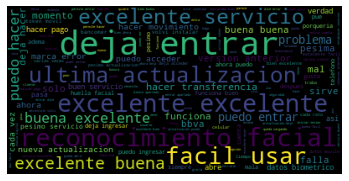

In [115]:
wc = WordCloud().generate_from_text(corpus)
#Use matplotlib.pyplot to display the fitted wordcloud
#Turn axis off to get rid of axis numbers
plt.imshow(wc)
plt.axis('off')
plt.show()

In [ ]:
#pip install stylecloud

<div class="alert-info">
 Realicé un segundo intento
</div>

In [116]:
import stylecloud

In [117]:
#pip install pillow

In [118]:
import PIL

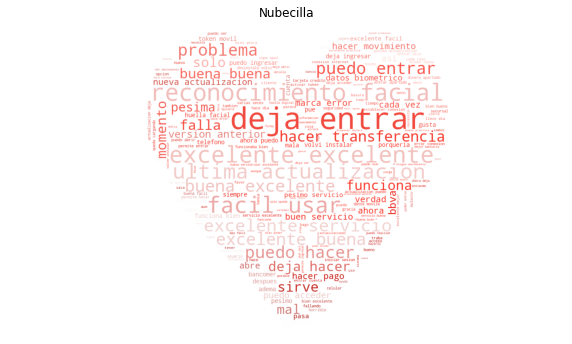

In [119]:
from PIL import Image 
from wordcloud import ImageColorGenerator

#Create the mask
heart_mask = np.array(Image.open('corazon-rojo.jpg'))

#Grab the mask colors
colors = ImageColorGenerator(heart_mask)

#Instantiate the wordcloud using color_func argument
cloud = WordCloud(mask=heart_mask,
                  background_color='white',
                  color_func=colors).generate_from_text(corpus)

#Plot the wordcloud
plt.figure(figsize=(10,8))
plt.imshow(cloud)
plt.axis('off')
plt.title("Nubecilla")
plt.show()

## Procesamiento de datos [10 puntos]
En esta parte tendrás que preparar los datos para poder entrenar modelos de aprendizaje de máquina. Para ello, tendrás que hacer lo siguiente:
* Separa el set de datos en set de variables independientes (X) y en variable target (y)
* Divide el set de datos en train (70%) y test (30%). Utiliza la semilla SEED=12345 para poder reproducir tus resultados

In [95]:
data.columns

Index(['id_id', 'd_at', 't_content', 'v_reviewCreatedVersion', 't_reviewId',
       'c_thumbsUpCount', 'tgt', 't_content_clean', 'list_of_words',
       'longitud'],
      dtype='object')

In [96]:
y=np.array(data["tgt"])
print("Target array shape is: {}\n".format(y.shape))
X=data.drop(columns=["tgt","id_id","t_reviewId","t_content"])
print("Features data frame shape is: {}\n".format(X.shape))

X_features=list(X.columns)

Target array shape is: (199998,)

Features data frame shape is: (199998, 6)



In [97]:
X_features

['d_at',
 'v_reviewCreatedVersion',
 'c_thumbsUpCount',
 't_content_clean',
 'list_of_words',
 'longitud']

In [98]:
X_train,X_test,y_train, y_test=train_test_split(X,y,test_size=0.3, random_state=SEED, shuffle=True)
print("X train represents {0:.2f}% of the data set".format(X_train.shape[0]/X.shape[0]*100))
print("X test represents {0:.2f}% of the data set".format(X_test.shape[0]/X.shape[0]*100))

X train represents 70.00% of the data set
X test represents 30.00% of the data set


In [99]:
def text_transformer(X_train, X_test, vectorizer, varToVector):
    """ Función para crear word embeddings (TF-IDF y BoW)
      
        Args: 
        X_train pandas dataframe
        X_test pandas dataframe
        varToVector string que contiene nombre de variable de texto
        vectorizer objeto para crear un word embedding de tipo TF-IDF y BoW
    """
    # Entrena método para convertir de texto a matrix numérica
    vectorizer_ = vectorizer
    vectorizer_.fit(X_train[varToVector])
    names=vectorizer_.get_feature_names()

    X_train = vectorizer_.transform(X_train[varToVector])
    X_test = vectorizer_.transform(X_test[varToVector])
    return X_train, X_test, names

**TF-IDF**

Investiga qué parámetros puede tomar e intenta optimizarlos. X_train_TFID y X_test_TFID serán los sets de datos que tendrás que utilizar para entrenar modelos en la sección siguiente

https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html

In [100]:
# Crea un word embedding de tipo TF-IDF con el objeto de Sklearn llamado TfidfVectorizer
# TfidfVectorizer(Por optimizar)
names=[]
X_train_TFID, X_test_TFID,names = text_transformer(X_train, X_test, TfidfVectorizer(),"t_content_clean")

# Convierte el resultado anterior en una matriz poco densa que pueda ser usada para entrenar un modelo
X_train_TFID = pd.DataFrame(X_train_TFID.toarray(),columns=names)
X_test_TFID = pd.DataFrame(X_test_TFID.toarray(),columns=names)

In [101]:
X_train_TFID.head()

,0000000,0054,01800bancomer,04marzo2020,05pm,072019,08feb21,0antalla,0ara,0asa,0ermite,0estrellas,0ouikkknnnmmnbvgxyytr,0uede,0uedes,0uedo,1000,10000,100mb,100pesos,1080p,10bla,10horas,10mb,10min,10pesos,10veces,1100,11134,11abril2020,11am,11ene21,11junio20,11pm,1400de,14ene2020,1500,1508,150gb,15agosto2020,15dias,15horas,16dig,16feb20,16gb,16mpx,1700mxn,17hrs,18sep20,190918,191003,1980,19de,19lo,1ano,1bbva,1edge,1era,1ero,1estrella,1extrella,1hora,1hra,1jun2020,1minuto,1queda,1ros,1seg,1semana,2003,200729,200807,200k,201216,2018,2019,2019la,2020,2021,20hrs,20lite,20mb,20mil,20min,20pro,20va,21he,21no,22de,22dias,22no,24horas,24hr,24hrs,24x7,250mb,25seg,266845,26segundos,2anos,...,ydespues,ydhd,ydisefallo,yeaaaa,yeaaaah,yeah,year,yebo,yeclado,yeficaz,yega,yegado,yegan,yeganddo,yegar,yegara,yegava,yege,yego,yeguen,yeha,yendo,yendome,yener,yevan,yevar,yevo,yeyo,yfzd,yhea,yhora,ylooo9o,ymarca,ymolesta,ymovia,ymui,ymuy,ynal,ynhay,ynno,ynome,ynooo,ynopuedes,yodas,yodo,yola,yolo,yomequedoencasa,yooo,yoooooo,your,youtube,ypegar,ypracticas,yransferencia,yrapido,ysalio,ysegura,ysencilla,ysiempre,ysigue,ysmada,ysobre,yubikey,yucatan,yudar,yuju,yupi,yupiiiiiiiiiii,yuri,yuridia,yuve,yvretiras,yvse,yvsin,yvya,yyhg,zacatecas,zamora,zamudo,zapato,zapatos,zapopan,zazzlez,zelanda,zero,zero2,zeta,zforce,zocalo,zona,zonas,zoom,ztev7,zulema,zumm,zuper,zuum,zuxzf,zzcv
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

<div class="alert-info">
 Dado que es un dataframe muy amplio, me guié en las últimas preguntas de la exploración para considerar solo las palabras que formaban el top (arbitrariamente escogí 30 de cada tipo de sentimiento, que al final se redujo a 47 variables, hay 13 tokens que aparecen tanto en pensamientos positivos como negativos)
</div>

In [102]:
X_train_TFID=X_train_TFID[propuesta1]

In [103]:
X_test_TFID=X_test_TFID[propuesta1]

In [104]:
X_train_TFID.head()

,excelente,buena,bien,facil,servicio,mejor,usar,hacer,puedo,practica,util,gracias,solo,deja,entrar,super,problema,movimientos,rapida,buen,funciona,encanta,cuenta,actualizacion,ahora,rapido,bbva,datos,genial,gusta,dice,facial,pesima,ingresar,permite,acceder,error,reconocimiento,cada,pide,apartados,tarjeta,queda,dias,dinero,ubicacion,anterior
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.146384,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.345855,0.0,0.0,0.0,0.0,0.169824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.383731,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.145283,0.146550,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.221447,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.238596,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.270897,0.0


In [105]:
X_train_TFID.shape

(139998, 47)

In [106]:
X_TFID=pd.concat([X_train_TFID,X_test_TFID],ignore_index=True)

In [107]:
X_TFID.head(5)

,excelente,buena,bien,facil,servicio,mejor,usar,hacer,puedo,practica,util,gracias,solo,deja,entrar,super,problema,movimientos,rapida,buen,funciona,encanta,cuenta,actualizacion,ahora,rapido,bbva,datos,genial,gusta,dice,facial,pesima,ingresar,permite,acceder,error,reconocimiento,cada,pide,apartados,tarjeta,queda,dias,dinero,ubicacion,anterior
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.146384,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.345855,0.0,0.0,0.0,0.0,0.169824,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.383731,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.145283,0.146550,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.221447,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.238596,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.270897,0.0


In [108]:
X_TFID.shape

(199998, 47)

In [109]:
# Revisa los rangos de las distintas variables independientes
pd.concat([X_train_TFID.min().rename('min'), X_train_TFID.max().rename('max')], axis=1)

,min,max
excelente,0.0,1.000000
buena,0.0,1.000000
bien,0.0,1.000000
facil,0.0,1.000000
servicio,0.0,1.000000
mejor,0.0,1.000000
usar,0.0,1.000000
hacer,0.0,0.768106
puedo,0.0,0.756761
practica,0.0,1.000000


In [110]:
y=np.concatenate(y_train, y_test,axis=0)

TypeError: concatenate() got multiple values for argument 'axis'

**Bag of Words (BoW)**
Investiga que parámetros puede tomar e intenta optimizarlos.
X_train_Bow y X_test_Bow serán los sets de datos que tendrás que utilizar para entrenar modelos en la sección siguiente

https://www.mygreatlearning.com/blog/bag-of-words/
https://www.analyticsvidhya.com/blog/2021/08/a-friendly-guide-to-nlp-bag-of-words-with-python-example/

In [ ]:
names=[]
X_train_BoW, X_test_BoW,names = text_transformer(X_train, X_test, CountVectorizer(max_features=60,max_df=0.7,min_df=5),"t_content_clean")

# Convierte el resultado anterior en una matriz poco densa que pueda ser usada para entrenar un modelo
X_train_BoW = pd.DataFrame(X_train_BoW.toarray(),columns=names)
X_test_BoW = pd.DataFrame(X_test_BoW.toarray(),columns=names)

In [ ]:
X_train_BoW.head()

In [ ]:
X_test_BoW.head()

In [ ]:
X_train_BoW.shape

Para ver las probabilidades del modelo
https://stackoverflow.com/questions/28716241/controlling-the-threshold-in-logistic-regression-in-scikit-learn

In [ ]:
X_BoW=pd.concat([X_train_BoW,X_test_BoW],ignore_index=True)

In [ ]:
X_BoW.head()

**[Strech: 20 puntos extras] Word embeddings más complejos**

Investiga técnicas más complejas para crear word embeddings y utilizalas en la sección de entrenamiento de modelos. ¿Crees que ayuden a mejorar el performance del modelo?
 


<div class="alert-info">
Se tienen algunas propuestas que pudieran emplearse con FastText. En la siguiente liga se pueden encontrar algunos ejemplos: 
    https://github.com/dccuchile/spanish-word-embeddings/blob/master/examples/Ejemplo_WordVectors.md
    </div>

## Entrena modelos de aprendizaje de máquina [30 puntos]
Entrena al menos tres tipos de modelos de clasificación. Todo modelo extra podrá ser considerado para puntos extras. Tienes la libertad de entrenar los modelos de la manera que desees, entre mejor sea la metodología de entrenamiento y evaluación de resultados, más puntos obtendrás. 

<div class="alert-info">

https://www.cienciadedatos.net/documentos/py14-ridge-lasso-elastic-net-python.html
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.Lasso.html?highlight=lasso#sklearn.linear_model.Lasso
</div>

In [ ]:
def grafica_matriz_confusion(cm, classes=[0,1], normalize=False, title='Matriz de confusión\n', cmap=plt.cm.Reds):
    """ 
    Función para mostrar la matriz de confusión de un problema de clasificación binario. 
    El parámetro cm puede ser el objeto resultante de ejecutar la función confusion_matrix() de la librería sklearn.
    
    Args:
        cm         matriz de confusión de sklearn
        classes    categorías de la variable target
        normalize  normaliza asignando el parámetro True
        title      string para definir el título para la gráfica
        cmap       mapa de colores
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    thresh = cm.max()
    text = [["VN =", "FN ="], ["FP =", "VP ="]]
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, "     {}".format(round (cm[i, j],2)), horizontalalignment="left",
                 color="white" if cm[i, j] > thresh else "black")
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, text[j][i] , horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('Valor real')
    plt.xlabel('Predicción')
    
def grafica_curva_roc(fpr, tpr, title='Curva ROC', note=''):
    """
    Función para graficar la curva ROC
    Los parámetros fpr y tpr son el output de ejecutar la función roc_curve de sklearn
    
    Args:
        fpr        Tasa de falsos positivos 
        tpr        Tasa de verdaderos positivos
        title      sting para definir el título de la gráfica
        note       Nota para mostrar en la gráfica
    """
    plt.figure(1)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(fpr, tpr)
    plt.xlabel('Tasa de falsos positivos ')
    plt.ylabel('Tasa de verdaderos positivos')
    plt.title(title)
    if note: plt.text(0.6, 0.2, note)
    plt.show()

## Considerando el conjunto X_TFID

### Lasso

In [ ]:
C_values = np.linspace(0.0001,1,11)
C_values

In [ ]:
from sklearn.pipeline import Pipeline

In [ ]:
# 3-Fold CV
# , 
cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("logit_model_l1",LogisticRegression()))
pipeline=Pipeline(estimators)
pipeline.set_params(logit_model_l1__penalty='l1')
pipeline.set_params(logit_model_l1__random_state=SEED)
pipeline.set_params(logit_model_l1__solver="liblinear")
#pipeline.set_params(logit_model_l2__n_jobs=N_JOBS)
#pipeline.set_params(logit_model_l1__multi_class="multinomial")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_TFID, y_train,
                                         param_name="logit_model_l1__C",
                                         param_range=C_values,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
train_scores

In [ ]:
# Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)


# Escoge el valor de C tal que:
# Maximice la efectividad en el test de validación
# Minimice la diferencia entre la métrica de efectividad en el set de datos de entrenamiento y validación
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))




In [ ]:
# Guarda el valor óptimo para C
optimum_parameter=C_values[choose_index]
# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(param_range,SM_list_train,color= "r")
    plt.plot(param_range,SM_list_test,"b")
    plt.axvline(x=optimum_parameter,color="g")#anteriormente tenía choose index
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    plt.xscale("log")
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,C_values,choose_index,
                            optimum_parameter,"C")

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de C
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(C_values, train_scores_mean_cv, test_scores_mean_cv)



In [ ]:
# Entrena un modelo final con el hyper parámetro C óptimo
pipeline.set_params(logit_model_l1__C = optimum_parameter)
logit_model_l1 = pipeline.named_steps['logit_model_l1']
logit_model_l1.fit(X_train_TFID,y_train)
accu_logit_model_l1 = logit_model_l1.score(X_test_TFID,y_test)
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_logit_model_l1))

**Calculamos métricas**

In [ ]:
y_pred_logit_l1=logit_model_l1.predict(X_test_TFID)
y_pred_proba_l1=logit_model_l1.predict_proba(X_test_TFID)

In [ ]:
matriz_confusion_logit_l1=confusion_matrix(y_test,y_pred_logit_l1)
grafica_matriz_confusion(matriz_confusion_logit_l1)

In [ ]:
#Calculamos efectividad
efectividad_logit_l1=matriz_confusion_logit_l1[0][0]+matriz_confusion_logit_l1[1][1]
print(" Aciertos = ",efectividad_logit_l1)
print("% Efectividad =",efectividad_logit_l1/len(y_pred_logit_l1))

In [ ]:
## La efectividad que calculo con la matriz es parecida a la que me devuelve bootstrap más adelante

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_logit_l1=matriz_confusion_logit_l1[1][1]/(matriz_confusion_logit_l1[1][1]+matriz_confusion_logit_l1[1][0])
precision_logit_l1=matriz_confusion_logit_l1[1][1]/(matriz_confusion_logit_l1[1][1]+matriz_confusion_logit_l1[0][1])
print(" % Recall = ",recall_logit_l1)
print(" % Precision =", precision_logit_l1)

                                        

In [ ]:
fpr_logit_l1,tpr_logit_l1,_=roc_curve(y_test,y_pred_logit_l1)
auc_logit_l1=roc_auc_score(y_test,y_pred_logit_l1)
grafica_curva_roc(fpr_logit_l1,tpr_logit_l1,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_logit_l1))

**El modelo es muy malo, ofrece lo mismo que el azar**


### Regresión logística Ridge (norma L2)


In [ ]:
C_values = np.logspace(-4, 6, 10, base = 10)
C_values

In [ ]:
# 3-Fold CV
# , 
cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("logit_model_l2",LogisticRegression()))
pipeline=Pipeline(estimators)
pipeline.set_params(logit_model_l2__penalty='l2')
pipeline.set_params(logit_model_l2__random_state=SEED)
pipeline.set_params(logit_model_l2__solver="lbfgs")
#pipeline.set_params(logit_model_l2__n_jobs=N_JOBS)
pipeline.set_params(logit_model_l2__multi_class="multinomial")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_TFID, y_train,
                                         param_name="logit_model_l2__C",
                                         param_range=C_values,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
train_scores

In [ ]:
# Gráfica los resultados para todos los valores del hyper parámetro C
# Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)


# Escoge el valor de C tal que:
# Maximice la efectividad en el test de validación
# Minimice la diferencia entre la métrica de efectividad en el set de datos de entrenamiento y validación
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))



In [ ]:
# Guarda el valor óptimo para C
optimum_parameter=C_values[choose_index]
# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(param_range,SM_list_train,color= "r")
    plt.plot(param_range,SM_list_test,"b")
    plt.axvline(x=choose_index,color="g")
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    plt.xscale("log")
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,C_values,choose_index,
                            optimum_parameter,"C")

In [ ]:
# Imprime el mejor valor para C
print("Valor óptimo para C es: {0:.5f}".format(optimum_parameter))

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de C
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(C_values, train_scores_mean_cv, test_scores_mean_cv)


In [ ]:
# Entrena un modelo final con el hyper parámetro C óptimo
pipeline.set_params(logit_model_l2__C = optimum_parameter)
logit_model_l2 = pipeline.named_steps['logit_model_l2']
logit_model_l2.fit(X_train_TFID,y_train)
accu_logit_model_l2 = logit_model_l2.score(X_test_TFID,y_test)
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_logit_model_l2))

**Estoy dudando de la construcción del pipeline ya que la efectividad que aquí encuentro dista mucho de la obtenida por matriz de confusión y se reafirma con las salidas de bootstrap**

In [ ]:
y_pred_logit_model_l2=logit_model_l2.predict(X_test_TFID)
y_pred_proba_l2=logit_model_l2.predict_proba(X_test_TFID)

In [ ]:
matriz_confusion_logit_l2=confusion_matrix(y_test,y_pred_logit_model_l2)
grafica_matriz_confusion(matriz_confusion_logit_l2)

In [ ]:
#Calculamos efectividad
efectividad_logit_l2=matriz_confusion_logit_l2[0][0]+matriz_confusion_logit_l2[1][1]
print(" Aciertos = ",efectividad_logit_l2)
print("% Efectividad =",efectividad_logit_l2/len(y_pred_logit_model_l2))

In [ ]:
## La efectividad que calculo con la matriz es parecida a la que me devuelve bootstrap más adelante

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_logit_l2=matriz_confusion_logit_l2[1][1]/(matriz_confusion_logit_l2[1][1]+matriz_confusion_logit_l2[1][0])
precision_logit_l2=matriz_confusion_logit_l2[1][1]/(matriz_confusion_logit_l2[1][1]+matriz_confusion_logit_l2[0][1])
print(" % Recall = ",recall_logit_l2)
print(" % Precision =", precision_logit_l2)

                                        

In [ ]:
fpr_logit_l2,tpr_logit_l2,_=roc_curve(y_test,y_pred_logit_model_l2)
auc_logit_l2=roc_auc_score(y_test,y_pred_logit_model_l2)
grafica_curva_roc(fpr_logit_l2,tpr_logit_l2,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_logit_l2))

#### Es malísimo el modelo

<div class="alert-info">
 K vecinos más cercanos, lo interrumpí por la falta de recursos
</div>

In [ ]:
# Utiliza el siguiente espacio para los valores que puede tomar el hyper parámetro K
K_values  = np.array([int(i) for i in np.linspace(1, 10, 10)])

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
model=KNeighborsClassifier()
cv_schema=StratifiedKFold(n_splits=3,random_state=SEED,shuffle=True)
# Utiliza la función validation_curve para entrenar y validar varios modelos (tantos como valores para el hyper parámetro K)
estimators=[]
estimators.append(("knn",model))
pipeline=Pipeline(estimators)
pipeline
train_scores,test_scores=validation_curve(pipeline,X_train_TFID, y_train,param_name="knn__n_neighbors",
                                         param_range= K_values,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
#Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)



# Escoge el valor de K tal que:
# Maximice la efectividad en el test de validación
# Minimice la diferencia entre la métrica de efectividad en el set de datos de entrenamiento y validación
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))



# Guarda el valor óptimo para K
optimum_parameter=K_values[choose_index]

# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(SM_list_train,color= "r")
    plt.plot(SM_list_test,"b")
    plt.axvline(x=choose_index,color="g")
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train KVecinos")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test KVecinos")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()    
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,C_values,choose_index,
                            optimum_parameter,"K")

In [ ]:
# Imprime el mejor valor para C
print("Valor óptimo para K es: {0:.5f}".format(optimum_parameter))

In [ ]:
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(K_values, train_scores_mean_cv, test_scores_mean_cv)

In [ ]:
# Entrena un modelo final con el hyper parámetro K óptimo
pipeline.set_params(knn__n_neighbors = optimum_parameter)
knn = pipeline.named_steps['knn']
knn.fit(X_train_TFID,y_train)
accu_knn = knn.score(X_test_TFID,y_test)


### Árbol de decisión


In [ ]:
max_depth=np.linspace(1,10,10)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("decision_tree",DecisionTreeClassifier()))
pipeline=Pipeline(estimators)
pipeline.set_params(decision_tree__criterion='gini')
pipeline.set_params(decision_tree__random_state= SEED)
pipeline.set_params(decision_tree__splitter="best")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_TFID, y_train,
                                         param_name="decision_tree__max_depth",
                                         param_range=max_depth,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
#Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)

In [ ]:
# Escoge el max depht
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))



# Guarda el valor óptimo para K
optimum_parameter=max_depth[choose_index]

# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(SM_list_train,color= "r")
    plt.plot(SM_list_test,"b")
    plt.axvline(x=optimum_parameter,color="g")#cambie choose parameter por optimum_parameter
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train Decision Tree")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test Decision Tree")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()    
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,max_depth,choose_index,
                            optimum_parameter,"Max_depth")

In [ ]:
# Imprime el mejor valor para max_depth
print("Valor óptimo Max_Depth es: {0:.5f}".format(optimum_parameter))

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de max_depth
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(max_depth, train_scores_mean_cv, test_scores_mean_cv)

In [ ]:
# Entrena un modelo final con el hyper parámetro max_depht óptimo
pipeline.set_params(decision_tree__max_depth = optimum_parameter)
decision_tree = pipeline.named_steps['decision_tree']
decision_tree.fit(X_train_TFID,y_train)
accu_decision_tree = decision_tree.score(X_test_TFID,y_test)

In [ ]:
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_decision_tree))

In [ ]:
y_pred_tree=decision_tree.predict(X_test_TFID)
y_pred_proba=decision_tree.predict_proba(X_test_TFID)

In [ ]:
matriz_confusion_tree=confusion_matrix(y_test,y_pred_tree)
grafica_matriz_confusion(matriz_confusion_tree)

In [ ]:
#Calculamos efectividad
efectividad_tree=matriz_confusion_tree[0][0]+matriz_confusion_tree[1][1]
print(" Aciertos = ",efectividad_tree)
print("% Efectividad =",efectividad_tree/len(y_pred_tree))

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_tree=matriz_confusion_tree[1][1]/(matriz_confusion_tree[1][1]+matriz_confusion_tree[1][0])
precision_tree=matriz_confusion_tree[1][1]/(matriz_confusion_tree[1][1]+matriz_confusion_tree[0][1])
print(" % Recall = ",recall_tree)
print(" % Precision =", precision_tree)

                                        

In [ ]:
fpr_tree,tpr_tree,_=roc_curve(y_test,y_pred_tree)
auc_tree=roc_auc_score(y_test,y_pred_tree)
grafica_curva_roc(fpr_tree,tpr_tree,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_tree))

In [ ]:
## Compara las métricas de los modelos anteriores
def print_metrics(classifier_name, metric_1_list, metric_2_list, metric_3_list, metric_4_list): 
    dash = '-' * 80
    print(dash)
    print('{:<20s}{:<15s}{:<15s}{:<15s}{:<15s}'.format('Clasificador','Efectividad', 'ROC AUC', 'recall', 'precision'))
    print(dash)
    for i in range(len(classifier_name)):
        print('{:<20s}{:<15.3f}{:<15.3f}{:<15.3f}{:<15.3f}'.format(classifier_name[i], metric_1_list[i], metric_2_list[i], metric_3_list[i], metric_4_list[i]))
    print(dash)

In [ ]:
# Agrega las métricas del modelo ensamble
classifiers = ['logit_model_l2', 'logit_model_l1', 'decision_tree']
accuracy = [efectividad_logit_l2/len(y_pred_logit_model_l2), efectividad_logit_l1/len(y_pred_logit_l1), efectividad_tree/len(y_pred_tree)]
roc_auc = [auc_logit_l2, auc_logit_l1, auc_tree]
recall = [recall_logit_l2, recall_logit_l1, recall_tree]
precision = [precision_logit_l2, precision_logit_l1, precision_tree]

# Imprime tabla de resultados
print_metrics(classifiers, accuracy, roc_auc, recall, precision)

#### Esta curva ROC no resultó mejor que las anteriores

## Selecciona el mejor modelo [15 puntos]
En esta parte debes seleccionar el mejor modelo, ya sea usando bootstrap o de la manera que creas adeacuada. Justifica bien tus decisiones

In [ ]:
num_records=y.shape[0]
bootstrap_accu_logit_model_l2=[]
bootstrap_accu_logit_model_l1=[]
bootstrap_accu_decision_tree=[]
#bootstrap_accu_knn=[]
for i in range(20):
    print("Iteración:{}".format(i))
    train_indices=np.random.choice(range(num_records),num_records,replace=True)
    test_indices=np.setdiff1d(range(num_records),train_indices)
    X_train_b,y_train_b=X_TFID.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_TFID.iloc[test_indices],y[test_indices]
    logit_model_l2.fit(X_train_b,y_train_b)
    bootstrap_accu_logit_model_l2.append(logit_model_l2.score(X_test_b,y_test_b))
    
    #Código para logistic regression l1 (Lasso)
    X_train_b,y_train_b=X_TFID.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_TFID.iloc[test_indices],y[test_indices]
    logit_model_l1.fit(X_train_b,y_train_b)
    bootstrap_accu_logit_model_l1.append(logit_model_l1.score(X_test_b,y_test_b))
    
    #Código para decision tree
    X_train_b,y_train_b=X_TFID.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_TFID.iloc[test_indices],y[test_indices]
    decision_tree.fit(X_train_b,y_train_b)
    bootstrap_accu_decision_tree.append(decision_tree.score(X_test_b,y_test_b)) 

In [ ]:
bootstrap_accu_logit_model_l2_sorted=np.sort(bootstrap_accu_logit_model_l2)
print("95% CIs")
print("Logit model L2: [{:f},{:f}]".format(bootstrap_accu_logit_model_l2_sorted[1],
                                           bootstrap_accu_logit_model_l2_sorted[18]))
 
bootstrap_accu_logit_model_l1_sorted=np.sort(bootstrap_accu_logit_model_l1)
print("95% CIs")
print("Logit model L1: [{:f},{:f}]".format(bootstrap_accu_logit_model_l1_sorted[1],bootstrap_accu_logit_model_l1_sorted[18]))


bootstrap_accu_decision_tree_sorted=np.sort(bootstrap_accu_decision_tree)
print("95% CIs")
print("Decision tree: [{:f},{:f}]".format(bootstrap_accu_decision_tree_sorted[1],bootstrap_accu_decision_tree_sorted[18]))

### De acuerdo con el resultado anterior, el bootstrap difiere de los análisis anteriores, lo cual puede deberse a la forma en la que construyo la matriz X_TFID (que fue concatenando X_train_TFID y X_test_TFID) o algún error en el código. 

### Si la decisión la tomo considerando las curvas ROC y la gran mayoría de las métricas, concluyo que es ligeramente mejor la regresiòn Ridge (logit l2)

# Considerando el conjunto X_BoW

### Lasso

In [ ]:
C_values = np.linspace(0.0001,1,11)
C_values

In [ ]:
from sklearn.pipeline import Pipeline

In [ ]:
# 3-Fold CV
# , 
cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("logit_model_l1",LogisticRegression()))
pipeline=Pipeline(estimators)
pipeline.set_params(logit_model_l1__penalty='l1')
pipeline.set_params(logit_model_l1__random_state=SEED)
pipeline.set_params(logit_model_l1__solver="liblinear")
#pipeline.set_params(logit_model_l2__n_jobs=N_JOBS)
#pipeline.set_params(logit_model_l1__multi_class="multinomial")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_BoW, y_train,
                                         param_name="logit_model_l1__C",
                                         param_range=C_values,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
train_scores

In [ ]:
# Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)


# Escoge el valor de C tal que:
# Maximice la efectividad en el test de validación
# Minimice la diferencia entre la métrica de efectividad en el set de datos de entrenamiento y validación
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))




In [ ]:
# Guarda el valor óptimo para C
optimum_parameter=C_values[choose_index]
# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(param_range,SM_list_train,color= "r")
    plt.plot(param_range,SM_list_test,"b")
    plt.axvline(x=choose_index,color="g")
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    plt.xscale("log")
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,C_values,choose_index,
                            optimum_parameter,"C")

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de C
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(C_values, train_scores_mean_cv, test_scores_mean_cv)



In [ ]:
# Entrena un modelo final con el hyper parámetro C óptimo
pipeline.set_params(logit_model_l1__C = optimum_parameter)
logit_model_l1 = pipeline.named_steps['logit_model_l1']
logit_model_l1.fit(X_train_BoW,y_train)
accu_logit_model_l1 = logit_model_l1.score(X_test_BoW,y_test)
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_logit_model_l1))

**Calculamos métricas**

In [ ]:
y_pred_logit_l1=logit_model_l1.predict(X_test_BoW)
y_pred_proba_l1=logit_model_l1.predict_proba(X_test_BoW)

In [ ]:
matriz_confusion_logit_l1=confusion_matrix(y_test,y_pred_logit_l1)
grafica_matriz_confusion(matriz_confusion_logit_l1)

In [ ]:
#Calculamos efectividad
efectividad_logit_l1=matriz_confusion_logit_l1[0][0]+matriz_confusion_logit_l1[1][1]
print(" Aciertos = ",efectividad_logit_l1)
print("% Efectividad =",efectividad_logit_l1/len(y_pred_logit_l1))

**Aquí si coincide con los resultados obtenidos del Pipene y hasta el momento es la de mejor efectividad**

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_logit_l1=matriz_confusion_logit_l1[1][1]/(matriz_confusion_logit_l1[1][1]+matriz_confusion_logit_l1[1][0])
precision_logit_l1=matriz_confusion_logit_l1[1][1]/(matriz_confusion_logit_l1[1][1]+matriz_confusion_logit_l1[0][1])
print(" % Recall = ",recall_logit_l1)
print(" % Precision =", precision_logit_l1)

                                        

In [ ]:
fpr_logit_l1,tpr_logit_l1,_=roc_curve(y_test,y_pred_logit_l1)
auc_logit_l1=roc_auc_score(y_test,y_pred_logit_l1)
grafica_curva_roc(fpr_logit_l1,tpr_logit_l1,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_logit_l1))

**El modelo mejora considerablemente, es el mejor hasta ahora**


### Regresión logística Ridge (norma L2)


In [ ]:
C_values = np.logspace(-4, 6, 10, base = 10)
C_values

In [ ]:
# 3-Fold CV
# , 
cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("logit_model_l2",LogisticRegression()))
pipeline=Pipeline(estimators)
pipeline.set_params(logit_model_l2__penalty='l2')
pipeline.set_params(logit_model_l2__random_state=SEED)
pipeline.set_params(logit_model_l2__solver="lbfgs")
#pipeline.set_params(logit_model_l2__n_jobs=N_JOBS)
pipeline.set_params(logit_model_l2__multi_class="multinomial")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_BoW, y_train,
                                         param_name="logit_model_l2__C",
                                         param_range=C_values,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
train_scores

In [ ]:
# Gráfica los resultados para todos los valores del hyper parámetro C
# Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)


# Escoge el valor de C tal que:
# Maximice la efectividad en el test de validación
# Minimice la diferencia entre la métrica de efectividad en el set de datos de entrenamiento y validación
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))



In [ ]:
# Guarda el valor óptimo para C
optimum_parameter=C_values[choose_index]
# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(param_range,SM_list_train,color= "r")
    plt.plot(param_range,SM_list_test,"b")
    plt.axvline(x=choose_index,color="g")
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    plt.xscale("log")
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,C_values,choose_index,
                            optimum_parameter,"C")

In [ ]:
# Imprime el mejor valor para C
print("Valor óptimo para C es: {0:.5f}".format(optimum_parameter))

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de C
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(C_values, train_scores_mean_cv, test_scores_mean_cv)


In [ ]:
# Entrena un modelo final con el hyper parámetro C óptimo
pipeline.set_params(logit_model_l2__C = optimum_parameter)
logit_model_l2 = pipeline.named_steps['logit_model_l2']
logit_model_l2.fit(X_train_BoW,y_train)
accu_logit_model_l2 = logit_model_l2.score(X_test_BoW,y_test)
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_logit_model_l2))

In [ ]:
y_pred_logit_model_l2=logit_model_l2.predict(X_test_BoW)
y_pred_proba_l2=logit_model_l2.predict_proba(X_test_BoW)

In [ ]:
matriz_confusion_logit_l2=confusion_matrix(y_test,y_pred_logit_model_l2)
grafica_matriz_confusion(matriz_confusion_logit_l2)

In [ ]:
#Calculamos efectividad
efectividad_logit_l2=matriz_confusion_logit_l2[0][0]+matriz_confusion_logit_l2[1][1]
print(" Aciertos = ",efectividad_logit_l2)
print("% Efectividad =",efectividad_logit_l2/len(y_pred_logit_model_l2))

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_logit_l2=matriz_confusion_logit_l2[1][1]/(matriz_confusion_logit_l2[1][1]+matriz_confusion_logit_l2[1][0])
precision_logit_l2=matriz_confusion_logit_l2[1][1]/(matriz_confusion_logit_l2[1][1]+matriz_confusion_logit_l2[0][1])
print(" % Recall = ",recall_logit_l2)
print(" % Precision =", precision_logit_l2)

                                        

In [ ]:
fpr_logit_l2,tpr_logit_l2,_=roc_curve(y_test,y_pred_logit_model_l2)
auc_logit_l2=roc_auc_score(y_test,y_pred_logit_model_l2)
grafica_curva_roc(fpr_logit_l2,tpr_logit_l2,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_logit_l2))

#### Es un poco menor la ROC AUC que se obtuvo en el modelo anterior


### Árbol de decisión


In [ ]:
max_depth=np.linspace(1,10,10)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

cv_schema= StratifiedKFold(n_splits=3, random_state=SEED, shuffle=True)
#N_JOBS= -1
estimators=[]
estimators.append(("decision_tree",DecisionTreeClassifier()))
pipeline=Pipeline(estimators)
pipeline.set_params(decision_tree__criterion='gini')
pipeline.set_params(decision_tree__random_state= SEED)
pipeline.set_params(decision_tree__splitter="best")
pipeline
#

In [ ]:
train_scores,test_scores=validation_curve(pipeline,X_train_BoW, y_train,
                                         param_name="decision_tree__max_depth",
                                         param_range=max_depth,
                                         cv=cv_schema, scoring="accuracy")

In [ ]:
#Saca el promedio de los resultados obtenidos en la parte de arriba
train_scores_mean_cv=np.mean(train_scores,axis=1)
test_scores_mean_cv=np.mean(test_scores,axis=1)

In [ ]:
# Escoge el max depht
choose_index_list=list(np.array(test_scores_mean_cv)-np.abs((np.array(train_scores_mean_cv)-np.array(test_scores_mean_cv))))
choose_index=choose_index_list.index(np.max(choose_index_list))



# Guarda el valor óptimo para K
optimum_parameter=max_depth[choose_index]

# Gráfica las curvas de efectividad en el set de datos de train y test
import matplotlib.lines as mlines
def plot_score_metric_train_test(SM_list_train,SM_list_test,param_range,choose_index,value_parameter,symbol_parameter):
    plt.plot(SM_list_train,color= "r")
    plt.plot(SM_list_test,"b")
    plt.axvline(x=optimum_parameter,color="g")#cambie choose parameter por optimum_parameter
    plt.title("Trade-off entre sesgo y varianza")
    plt.xlabel("Hyper parámetro: {}".format(symbol_parameter))
    plt.ylabel("Efectividad")
    plt.ylim(0.0,1.1)
    
    
    train=mlines.Line2D([],[],color="r",marker="",
                        markersize=15, label="Curva en train Decision Tree")
    test=mlines.Line2D([],[],color="b",marker="",
                      markersize=15, label="Curva en test Decision Tree")
    opt_value=mlines.Line2D([],[],color="g",marker="",
                      markersize=15, label="Valor óptimo:{0:.5f}".format(value_parameter))
    plt.legend(handles=[train, test,opt_value])
    plt.show()    
# Gráfica las curvas de performance en cada set de datos
plot_score_metric_train_test(train_scores_mean_cv,test_scores_mean_cv,max_depth,choose_index,
                            optimum_parameter,"Max_depth")

In [ ]:
# Imprime el mejor valor para max_depth
print("Valor óptimo Max_Depth es: {0:.5f}".format(optimum_parameter))

In [ ]:
# Imprime las métricas de efectividad en train y test para cada valor de max_depth
def print_cv_validation_scores(parameter, train_accu_mean_scores, test_accu_mean_scores):
    dash = '-' * 100
    print(dash)
    print('{:<30s}{:<35s}{:<25s}'.format('Valor de Hyper parámetro','Efectividad media en train', 'Efectividad media en test'))
    print(dash)
    for i in range(len(parameter)):
        print('{:<30.4f}{:<35.3f}{:<25.3f}'.format(parameter[i], train_accu_mean_scores[i], test_accu_mean_scores[i]))
        print(dash)
    
print_cv_validation_scores(max_depth, train_scores_mean_cv, test_scores_mean_cv)

In [ ]:
# Entrena un modelo final con el hyper parámetro max_depht óptimo
pipeline.set_params(decision_tree__max_depth = optimum_parameter)
decision_tree = pipeline.named_steps['decision_tree']
decision_tree.fit(X_train_BoW,y_train)
accu_decision_tree = decision_tree.score(X_test_BoW,y_test)

In [ ]:
print ("Efectividad del modelo: {0:.2f}%".format(100*accu_decision_tree))

In [ ]:
y_pred_tree=decision_tree.predict(X_test_BoW)
y_pred_proba=decision_tree.predict_proba(X_test_BoW)

In [ ]:
matriz_confusion_tree=confusion_matrix(y_test,y_pred_tree)
grafica_matriz_confusion(matriz_confusion_tree)

In [ ]:
#Calculamos efectividad
efectividad_tree=matriz_confusion_tree[0][0]+matriz_confusion_tree[1][1]
print(" Aciertos = ",efectividad_tree)
print("% Efectividad =",efectividad_tree/len(y_pred_tree))

In [ ]:
#Calculamos el recall y la precisión de la predicción
recall_tree=matriz_confusion_tree[1][1]/(matriz_confusion_tree[1][1]+matriz_confusion_tree[1][0])
precision_tree=matriz_confusion_tree[1][1]/(matriz_confusion_tree[1][1]+matriz_confusion_tree[0][1])
print(" % Recall = ",recall_tree)
print(" % Precision =", precision_tree)

                                        

In [ ]:
fpr_tree,tpr_tree,_=roc_curve(y_test,y_pred_tree)
auc_tree=roc_auc_score(y_test,y_pred_tree)
grafica_curva_roc(fpr_tree,tpr_tree,"Curva Roc",note="ROC AUC: {0:.5f}".format(auc_tree))

#### Esta curva ROC no resultó mejor que las anteriores

## Selecciona el mejor modelo [15 puntos]
En esta parte debes seleccionar el mejor modelo, ya sea usando bootstrap o de la manera que creas adeacuada. Justifica bien tus decisiones

In [ ]:
num_records=y.shape[0]
bootstrap_accu_logit_model_l2=[]
bootstrap_accu_logit_model_l1=[]
bootstrap_accu_decision_tree=[]
#bootstrap_accu_knn=[]
for i in range(20):
    print("Iteración:{}".format(i))
    train_indices=np.random.choice(range(num_records),num_records,replace=True)
    test_indices=np.setdiff1d(range(num_records),train_indices)
    X_train_b,y_train_b=X_BoW.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_BoW.iloc[test_indices],y[test_indices]
    logit_model_l2.fit(X_train_b,y_train_b)
    bootstrap_accu_logit_model_l2.append(logit_model_l2.score(X_test_b,y_test_b))
    
    #Código para logistic regression l1 (Lasso)
    X_train_b,y_train_b=X_BoW.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_BoW.iloc[test_indices],y[test_indices]
    logit_model_l1.fit(X_train_b,y_train_b)
    bootstrap_accu_logit_model_l1.append(logit_model_l1.score(X_test_b,y_test_b))
    
    #Código para decision tree
    X_train_b,y_train_b=X_BoW.iloc[train_indices],y[train_indices]
    X_test_b,y_test_b=X_BoW.iloc[test_indices],y[test_indices]
    decision_tree.fit(X_train_b,y_train_b)
    bootstrap_accu_decision_tree.append(decision_tree.score(X_test_b,y_test_b)) 

In [ ]:
bootstrap_accu_logit_model_l2_sorted=np.sort(bootstrap_accu_logit_model_l2)
print("95% CIs")
print("Logit model L2: [{:f},{:f}]".format(bootstrap_accu_logit_model_l2_sorted[1],bootstrap_accu_logit_model_l2_sorted[18]))
 
bootstrap_accu_logit_model_l1_sorted=np.sort(bootstrap_accu_logit_model_l1)
print("95% CIs")
print("Logit model L1: [{:f},{:f}]".format(bootstrap_accu_logit_model_l1_sorted[1],bootstrap_accu_logit_model_l1_sorted[18]))


bootstrap_accu_decision_tree_sorted=np.sort(bootstrap_accu_decision_tree)
print("95% CIs")
print("Decision tree: [{:f},{:f}]".format(bootstrap_accu_decision_tree_sorted[1],bootstrap_accu_decision_tree_sorted[18]))

## Nuevamente ocurre algo extraño con mi código en bootstrap. Bajo esta matriz, los resultados de los modelos de regresión Ridge y Lasso son exactamente los misjos, mejores que los del árbol de decisón.